# 支持向量
高斯核函数的支持向量机（SVM）来构建垃圾邮件分类器

### 初步了解

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sb
from scipy.io import loadmat

In [2]:
raw_data = loadmat('../data/andrew_ml_ex67101/ex6data1.mat')
data = pd.DataFrame(raw_data.get('X'), columns=['X1', 'X2'])
data['y'] = raw_data.get('y')

data.head()

,X1,X2,y
0,1.9643,4.5957,1
1,2.2753,3.8589,1
2,2.9781,4.5651,1
3,2.9320,3.5519,1
4,3.5772,2.8560,1


In [3]:
# 作图展示
def plot_init_data(data, fig, ax):
    positive = data[data['y'].isin([1])]
    negative = data[data['y'].isin([0])]
    ax.scatter(positive['X1'], positive['X2'], s=50, marker='x', label='Positive')
    ax.scatter(negative['X1'], negative['X2'], s=50, marker='o', label='Negative')

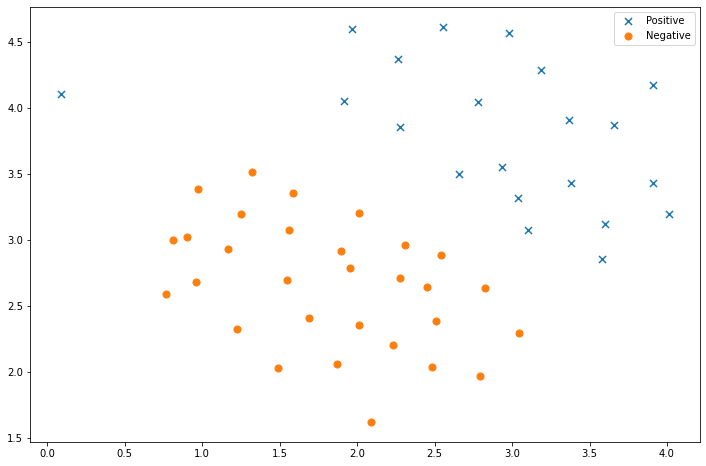

In [5]:
fig,ax = plt.subplots(figsize=(12,8))
plot_init_data(data, fig, ax)
ax.legend()
plt.show()

注意这里一个异常的正例在其他样本之外。 这些类仍然是线性分离的，但它非常紧凑。 我们要训练线性支持向量机来学习类边界。

In [6]:
from sklearn import svm
# C：一个浮点数，惩罚参数
# loss：字符串。表示损失函数。可取值为
# 'hinge'：合页损失函数；
# 'squared_hinge'：合页损失函数的平方
# max_iter:一个整数，指定最大的迭代次数
svc = svm.LinearSVC(C=1, loss='hinge', max_iter=1000)
svc

LinearSVC(C=1, class_weight=None, dual=True, fit_intercept=True,
          intercept_scaling=1, loss='hinge', max_iter=1000, multi_class='ovr',
          penalty='l2', random_state=None, tol=0.0001, verbose=0)

In [17]:
# fit（self，X，y [，sample_weight]）根据给定的训练数据拟合SVM模型。
#score（self，X，y [，sample_weight]） 返回给定测试数据和标签上的平均准确度。
svc.fit(data[['X1', 'X2']], data['y'])
svc.score(data[['X1', 'X2']], data['y'])

0.9803921568627451

In [19]:
# 训练后预测[4.5,4.5] 从原始图可以看出来应该时y=1 [1,1] 点应该为0
svc.predict([[4.5,4.5],[1,1]])

array([1, 0], dtype=uint8)

In [14]:
# 图像展示
#   决策边界
def find_decision_boundary(svc, x1min, x1max, x2min, x2max, diff):
    x1 = np.linspace(x1min,x1max,1000)
    x2 = np.linspace(x2min, x2max, 1000)
    # 面铺满点
    cordinates = [(x, y) for x in x1 for y in x2]
    x_cord, y_cord = zip(*cordinates)
    c_val = pd.DataFrame({'x1':x_cord, 'x2':y_cord})
    # 返回模型中每个类的样本决策函数。
    c_val['cval'] = svc.decision_function(c_val[['x1', 'x2']])
    # 选择决策大于diff
    decision = c_val[np.abs(c_val['cval']) < diff]
    return decision.x1, decision.x2

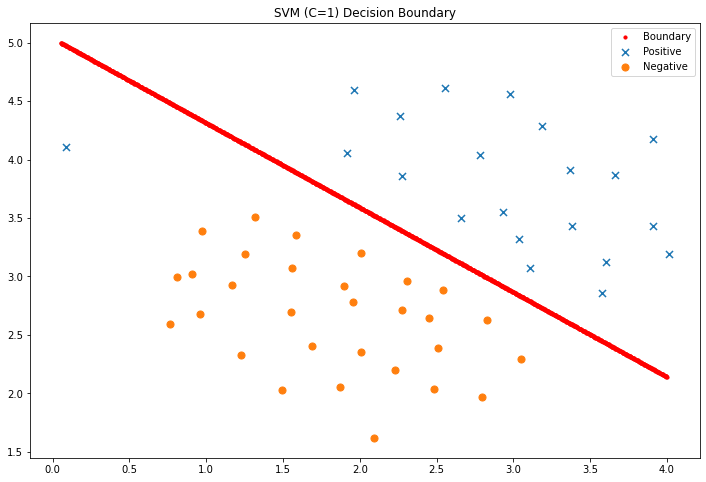

In [15]:
x1, x2 = find_decision_boundary(svc, 0, 4, 1.5, 5, 2 * 10**-3)
fig, ax = plt.subplots(figsize=(12,8))
ax.scatter(x1, x2, s=10, c='r',label='Boundary')
plot_init_data(data, fig, ax)
ax.set_title('SVM (C=1) Decision Boundary')
ax.legend()
plt.show()

## 高斯内核的SVM
用内核函数模拟复杂分类，从线性SVM转移到能够使用内核进行非线性分类的SVM。 scikit-learn具有内置的高斯内核，但为了实现更清楚，我们将从头开始实现

In [41]:
# 高斯内核函数
def gaussian_kernel(x,l,sigma):
    return np.exp(-(np.sum((x - l)**2))/(2*np.power(sigma,2)))

In [42]:
x1 = np.array([[1.0, 2.0, 1.0],[2.0, 2.0, 1.0]])
x2 = np.array([0.0, 4.0, -1.0])
sigma = 2

gaussian_kernel(x1, x2, sigma)

0.07243975703425146

### 使用高斯核函数找到非线性回归边界

[0.107143 0.60307 ] [1]


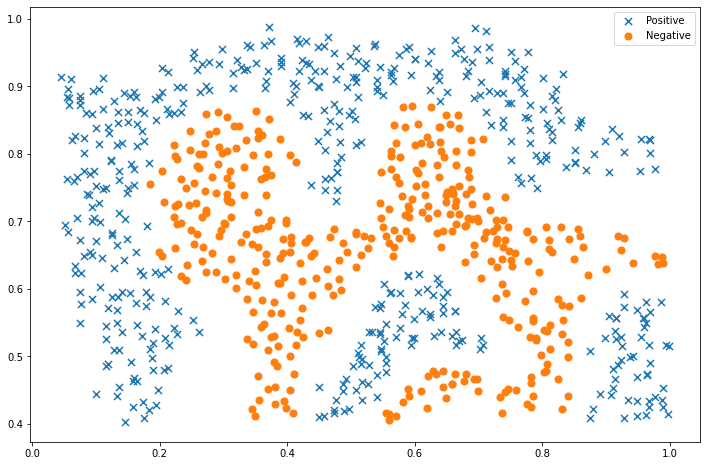

In [30]:
# 新的数据集
raw_data = loadmat('../data/andrew_ml_ex67101/ex6data2.mat')
print(raw_data['X'][0],raw_data['y'][0])
data = pd.DataFrame(raw_data['X'], columns=['X1', 'X2'])
data['y'] = raw_data['y']
fig, ax = plt.subplots(figsize=(12,8))
plot_init_data(data, fig, ax)
ax.legend()
plt.show()

In [44]:
# gamma内核系数
# 核函数选择 ‘linear’, ‘poly’, ‘rbf’, ‘sigmoid’, ‘precomputed’ or a callable
# 但是这里我们使用自己的核函数 是否启用概率估计
# def my_kernel(X, Y):
#     """
#     We create a custom kernel:

#                  (2  0)
#     k(X, Y) = X  (    ) Y.T
#                  (0  1)
#     """
#     M = np.array([[2, 0], [0, 1.0]])
#     return np.dot(np.dot(X, M), Y.T)

In [58]:
svc = svm.SVC(C=100, gamma=10 ,probability=True)
svc

SVC(C=100, break_ties=False, cache_size=200, class_weight=None, coef0=0.0,
    decision_function_shape='ovr', degree=3, gamma=10, kernel='rbf',
    max_iter=-1, probability=True, random_state=None, shrinking=True, tol=0.001,
    verbose=False)

In [59]:
svc.fit(data[['X1', 'X2']], data['y'])
svc.score(data[['X1', 'X2']], data['y']) # 

0.9698725376593279

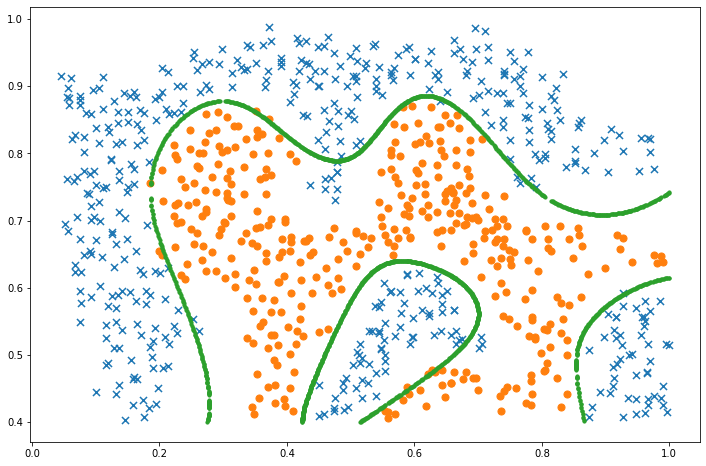

In [51]:
x1, x2 = find_decision_boundary(svc, 0, 1, 0.4, 1, 0.01)
fig, ax = plt.subplots(figsize=(12,8))
plot_init_data(data, fig, ax)
ax.scatter(x1, x2, s=10)
plt.show()

### 根据交叉测试集，找到合适的C和σ

In [61]:
C_values = [0.01, 0.03, 0.1, 0.3, 1, 3, 10, 30, 100]
gamma_values = [0.01, 0.03, 0.1, 0.3, 1, 3, 10, 30, 100]
# 这里使用训练集代替
best_score = 0
best_params = {'C': None, 'gamma': None}

for C in C_values:
    for gamma in gamma_values:
        svc = svm.SVC(C=C, gamma=gamma)
        svc.fit(data[['X1', 'X2']], data['y'])
        score=svc.score(data[['X1', 'X2']], data['y']) # 返回的是平均准确度
        # score = svc.score(Xval, yval)
        if score > best_score:
            best_score = score
            best_params['C'] = C
            best_params['gamma'] = gamma

best_score, best_params

(0.9988412514484357, {'C': 100, 'gamma': 100})

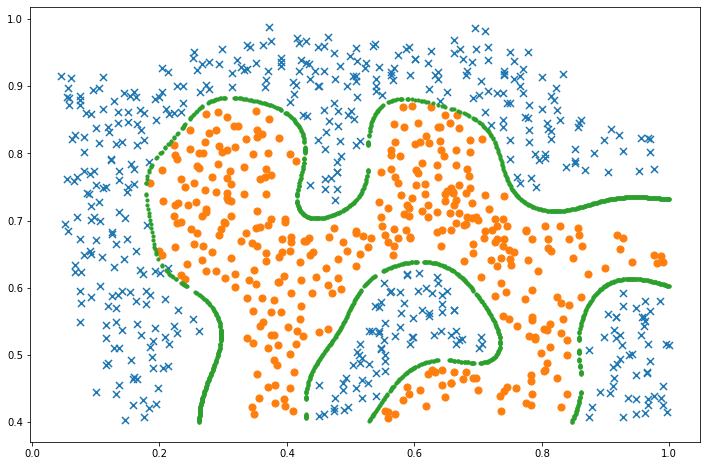

In [62]:
svc = svm.SVC(C=best_params['C'], gamma=best_params['gamma'])
svc.fit(data[['X1', 'X2']], data['y'])
x1, x2 = find_decision_boundary(svc, 0, 1, 0.4, 1, 0.01)
fig, ax = plt.subplots(figsize=(12,8))
plot_init_data(data, fig, ax)
ax.scatter(x1, x2, s=10)
plt.show()

## 垃圾邮件分类
这2个部分是处理邮件，以获得适合SVM处理的格式的数据。 然而，这个任务很简单（将字词映射到为练习提供的字典中的ID），而其余的预处理步骤（如HTML删除，词干，标准化等）已经完成。 我们就直接读取预先处理好的数据就可以了。

In [63]:
# 训练垃圾邮件分类SVM
spam_train = loadmat('../data/andrew_ml_ex67101/spamTrain.mat')
spam_test = loadmat('../data/andrew_ml_ex67101/spamTest.mat')

spam_train

{'__header__': b'MATLAB 5.0 MAT-file, Platform: GLNXA64, Created on: Sun Nov 13 14:27:25 2011',
 '__version__': '1.0',
 '__globals__': [],
 'X': array([[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 1, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]], dtype=uint8),
 'y': array([[1],
        [1],
        [0],
        ...,
        [1],
        [0],
        [0]], dtype=uint8)}

In [64]:
X = spam_train['X']
Xtest = spam_test['Xtest']
y = spam_train['y'].ravel()
ytest = spam_test['ytest'].ravel()

X.shape, y.shape, Xtest.shape, ytest.shape

((4000, 1899), (4000,), (1000, 1899), (1000,))

In [65]:
# 每个文档已经转换为一个向量，其中1,899个维对应于词汇表中的1,899个单词。 它们的值为二进制，表示文档中是否存在单词。
svc = svm.SVC()
svc.fit(X, y) # 根据训练集训练svm模型

SVC(C=1.0, break_ties=False, cache_size=200, class_weight=None, coef0=0.0,
    decision_function_shape='ovr', degree=3, gamma='scale', kernel='rbf',
    max_iter=-1, probability=False, random_state=None, shrinking=True,
    tol=0.001, verbose=False)

In [83]:
print(svc.score(Xtest,ytest))# 预测准确度

0.987


In [76]:
# # # 结果
kw = np.eye(1899)# 1899个特征值
spam_val = pd.DataFrame({'idx':range(1899)})
spam_val['isspam'] = svc.decision_function(kw) #返回决策函数值（比如svm中的决策距离）
spam_val['isspam'].describe()
# spam_val['isspam'].shape (1899,)

count    1899.000000
mean       -0.110039
std         0.049094
min        -0.428396
25%        -0.131213
50%        -0.111985
75%        -0.091973
max         0.396286
Name: isspam, dtype: float64

In [80]:
# decision = spam_val[spam_val['isspam'] > -0.55] # 决策距离
# decision['idx']

0          0
1          1
2          2
3          3
4          4
        ... 
1894    1894
1895    1895
1896    1896
1897    1897
1898    1898
Name: idx, Length: 1899, dtype: int64

In [106]:
path =  '../data/andrew_ml_ex67101/vocab.txt'
voc = pd.read_csv(path, header=None, names=['idx', 'voc'], sep = '\t')
voc.head()

,idx,voc
0,1,aa
1,2,ab
2,3,abil
3,4,abl
4,5,about


In [101]:
# 提取
def readtxt(path,encoding):
    with open(path, 'r', encoding = encoding) as f:
        lines = f.readlines()
    return lines
# 内容清洗整理
def email_parser(email_path):
    punctuations = """,.<>()*&^%$#@!:'";~`[]{}|、\\/~+_-=?"""
    content_list = readtxt(email_path, 'utf8')
    content = (' '.join(content_list)).replace('\r', ' ').replace('\t', ' ').replace('\n', ' ')
    clean_word = []+
    for punctuation in punctuations:
        content = (' '.join(content.split(punctuation))).replace('  ', ' ')
        clean_word = [word.lower()
                      for word in content.split(' ') if len(word) >= 2]
    return clean_word

In [104]:
clean_email = email_parser('../data/andrew_ml_ex67101/emailSample1.txt')

In [114]:
# 转换数据集
def convertSet(voc,clean_email):
    Xsample1 = np.zeros(X.shape[1])
    mask = np.isin(voc['voc'],np.array(clean_email))
    Xsample1[mask] = 1
    return Xsample1
convertSet(voc,clean_email)

array([0., 0., 0., ..., 0., 0., 0.])

In [117]:
# 预测 
spam_email = email_parser('../data/andrew_ml_ex67101/spamSample1.txt')
svc.predict([convertSet(voc,clean_email),convertSet(voc,spam_email)])#可以看到预测就俄国array([0, 1], dtype=uint8)

array([0, 1], dtype=uint8)

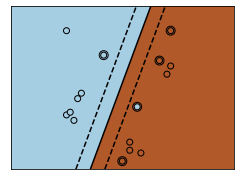

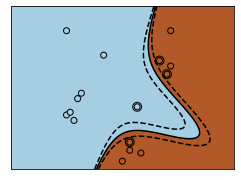

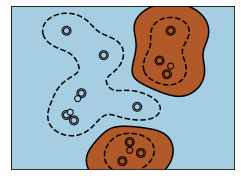

In [12]:
# 官方示例展示可视化分类边界
import numpy as np
import matplotlib.pyplot as plt
from sklearn import svm
# Our dataset and targets
X = np.c_[(.4, -.7),
          (-1.5, -1),
          (-1.4, -.9),
          (-1.3, -1.2),
          (-1.1, -.2),
          (-1.2, -.4),
          (-.5, 1.2),
          (-1.5, 2.1),
          (1, 1),
          (1.3, .8),
          (1.2, .5),
          (.2, -2),
          (.5, -2.4),
          (.2, -2.3),
          (0, -2.7),
          (1.3, 2.1)].T
Y = [0] * 8 + [1] * 8

# figure number
fignum = 1

# fit the model
for kernel in ('linear', 'poly', 'rbf'):
    clf = svm.SVC(kernel=kernel, gamma=2)
    clf.fit(X, Y)

    # plot the line, the points, and the nearest vectors to the plane
    plt.figure(fignum, figsize=(4, 3))
    plt.clf()

    plt.scatter(clf.support_vectors_[:, 0], clf.support_vectors_[:, 1], s=80,
                facecolors='none', zorder=10, edgecolors='k')
    plt.scatter(X[:, 0], X[:, 1], c=Y, zorder=10, cmap=plt.cm.Paired,
                edgecolors='k')

    plt.axis('tight')
    x_min = -3
    x_max = 3
    y_min = -3
    y_max = 3

    XX, YY = np.mgrid[x_min:x_max:200j, y_min:y_max:200j]
    Z = clf.decision_function(np.c_[XX.ravel(), YY.ravel()])

    # Put the result into a color plot
    Z = Z.reshape(XX.shape)
    plt.figure(fignum, figsize=(4, 3))
    plt.pcolormesh(XX, YY, Z > 0, cmap=plt.cm.Paired)
    plt.contour(XX, YY, Z, colors=['k', 'k', 'k'], linestyles=['--', '-', '--'],
                levels=[-.5, 0, .5])

    plt.xlim(x_min, x_max)
    plt.ylim(y_min, y_max)

    plt.xticks(())
    plt.yticks(())
    fignum = fignum + 1
plt.show()

In [13]:
Y

[0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1]

还有一个异常的正例在其他样本之外。 这些类仍然是线性分离的，但它非常紧凑。 我们要训练线性支持向量机来学习类边界。